In [1]:
rm(list = ls())
set.seed(1234)
options(future.seed = TRUE)
Sys.setenv(RETICULATE_PYTHON = "/home/gonglihao/miniconda3/envs/42/bin/python")

suppressPackageStartupMessages({
    library("dplyr")
    library("Matrix")
    library("Seurat")
    library("future.apply")
    library("tictoc")
    library("ggplot2")
    library("ggpubr")
    library("future")
    library("harmony")
    library("parallel")
    library("patchwork")
    library("ggrepel")
    library("COSG")
})

plan("multicore", workers = 54)
options(future.globals.maxSize = Inf)
combined <- readRDS("/data3/Group8/gonglihao/1-MMP9/3-Annotation/anno-0.6.rds")

In [2]:
target_celltypes <- c("Mono/Mac", "Mac", "DC")

In [3]:
seu <- subset(combined, celltype %in% target_celltypes)
tic()
# 标准化
seu <- NormalizeData(seu,
                    normalization.method = "LogNormalize",
                    scale.factor = 10000,
                    block.size = 800)

# 寻找高变基因
seu <- FindVariableFeatures(seu,
                          selection.method = "vst",
                          nfeatures = 2000)

# 数据标准化
plan("sequential")  # 临时切换到串行模式
seu <- ScaleData(seu,
                features = rownames(seu),
                block.size = 1000,
                min.cells.to.block = 1000)
plan("multicore", workers = 54)  # 恢复并行模式
toc()

tic()
# 运行PCA
seu <- RunPCA(seu, npcs = 30, verbose = FALSE)

# 运行Harmony
seu <- RunHarmony(seu,
                 group.by.vars = "orig.ident",
                 seed.use = 1234)

# 运行UMAP
seu <- RunUMAP(seu,
              reduction = "harmony",
              dims = 1:30,
              umap.method = "umap-learn",
              metric = "correlation",
              verbose = FALSE)
toc()

seu <- FindNeighbors(object = seu,
                    dims = 1:30,
                    verbose = FALSE, 
                    reduction = "harmony")

# 不同分辨率的聚类和可视化
resolution.range <- seq(0.1, 1.2, by = 0.1)
plot_list <- list()

for (res in resolution.range) {
    # 进行聚类
    seu <- FindClusters(seu,
        resolution = res,
        verbose = FALSE,
        random.seed = 1234)
    
    cluster_column <- paste0("RNA_snn_res.", res)
    
    p <- DimPlot(seu,
        reduction = "umap",
        group.by = cluster_column,
        label = TRUE,
        label.size = 4) +
        ggtitle(paste("Resolution:", res))
    
    plot_list[[length(plot_list) + 1]] <- p
}

Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix



8.5 sec elapsed


Transposing data matrix

Initializing state using k-means centroids initialization

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony converged after 4 iterations



74.447 sec elapsed


Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "igno

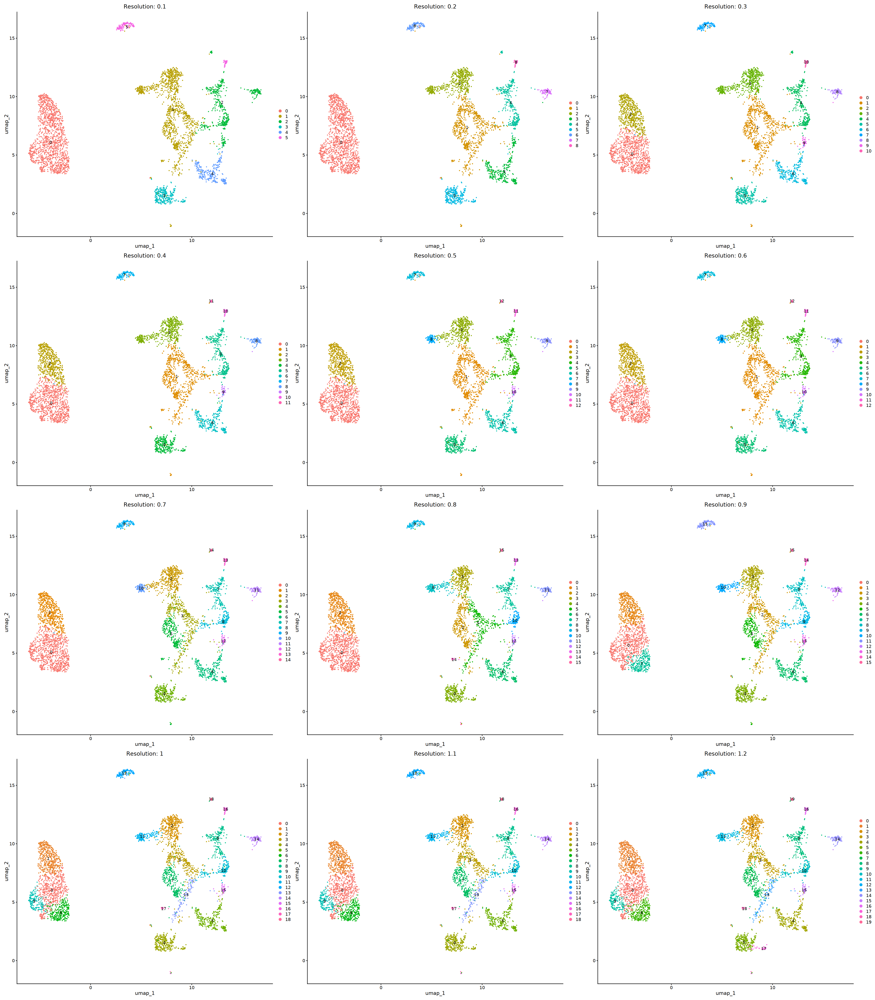

In [4]:
options(repr.plot.width = 35, repr.plot.height = 40)
wrap_plots(plot_list, ncol = 3)

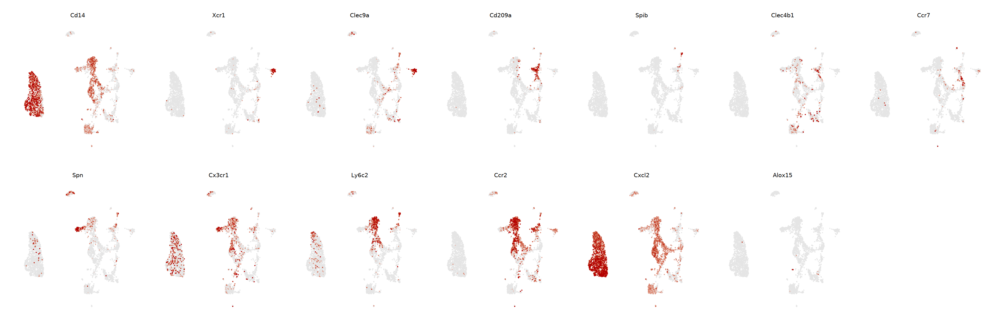

In [6]:
# 设置图形大小
options(repr.plot.width = 30, repr.plot.height = 10)

# 创建FeaturePlot
FeaturePlot(seu,
    features = c( "Cd14", "Xcr1", "Clec9a", "Cd209a", "Spib", "Clec4b1", "Ccr7","Spn", "Cx3cr1", "Ly6c2", "Ccr2", "Cxcl2", "Alox15"),
    ncol = 7,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

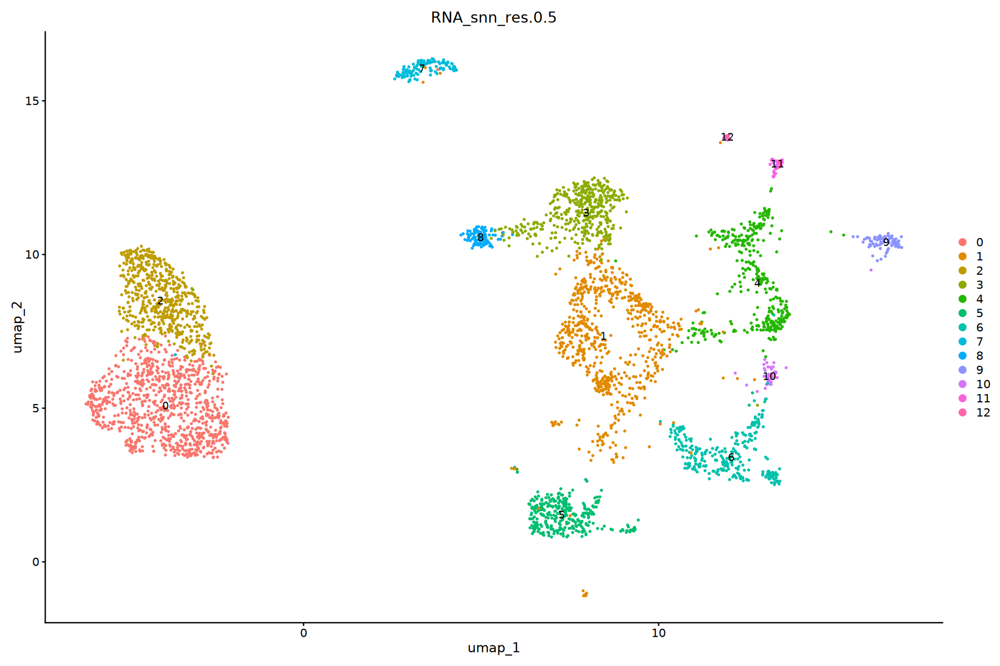

In [8]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(seu,
        reduction = "umap",
        group.by = "RNA_snn_res.0.5",
        label = TRUE,
        label.size = 4,
        pt.size = 0.5)

In [9]:
library(writexl)
output_path <- "/data3/Group8/gonglihao/1-MMP9/5-sub/"
cluster_col <- "RNA_snn_res.0.5"
seu <- JoinLayers(seu)
Idents(seu) <- cluster_col

cosg_markers <- cosg(
   seu,
   groups = 'all',
   mu = 1
)

avg_expr <- AggregateExpression(
   seu,
   group.by = cluster_col,
   assays = "RNA"
)$RNA

cluster_vec <- rep(names(cosg_markers$names), sapply(cosg_markers$names, length))
genes_vec <- unlist(cosg_markers$names)
scores_vec <- unlist(cosg_markers$scores)

cosg_results_df <- data.frame(
   cluster = cluster_vec,
   Gene = genes_vec,
   Score = scores_vec,
   stringsAsFactors = FALSE
)

cluster_names <- paste0("g", cosg_results_df$cluster)
cosg_results_df$Avg_Expression <- NA

genes_match <- match(cosg_results_df$Gene, rownames(avg_expr))
clusters_match <- match(cluster_names, colnames(avg_expr))
valid_indices <- !is.na(genes_match) & !is.na(clusters_match)
cosg_results_df$Avg_Expression[valid_indices] <- round(
   avg_expr[cbind(
       genes_match[valid_indices], 
       clusters_match[valid_indices]
   )],
   3
)

cosg_results_df$cluster <- as.numeric(cosg_results_df$cluster)
cosg_results_df <- cosg_results_df[order(cosg_results_df$cluster, -cosg_results_df$Score),]

excel_data <- split(cosg_results_df, cosg_results_df$cluster)
excel_data <- lapply(excel_data, function(x) {
   x <- x[order(-x$Score),]
   x$cluster <- NULL
   return(x)
})
names(excel_data) <- paste0("Cluster", names(excel_data))

resolution <- sub(".*res\\.", "", cluster_col)

excel_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".xlsx")
csv_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".csv")

write_xlsx(excel_data, path = file.path(output_path, excel_filename))
data.table::fwrite(cosg_results_df, file = file.path(output_path, csv_filename))

Warning message:
“x or y has vectors with all zero; consider setting use_nan = TRUE to set these values to NaN or use_nan = FALSE to suppress this warning”
First group.by variable `RNA_snn_res.0.5` starts with a number, appending `g` to ensure valid variable names
This message is displayed once every 8 hours.


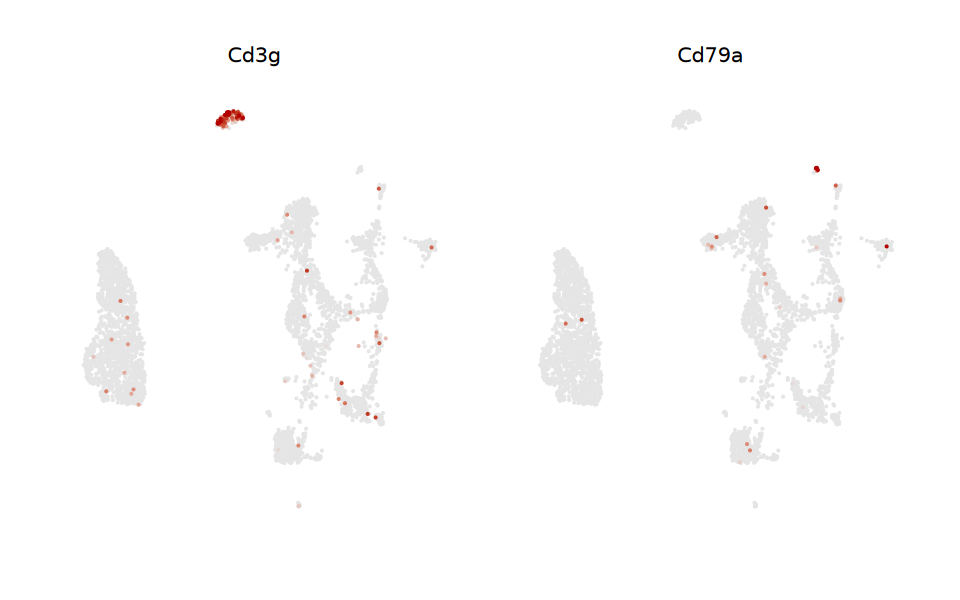

In [10]:
# 设置图形大小
options(repr.plot.width = 8, repr.plot.height = 5)

# 创建FeaturePlot
FeaturePlot(seu,
    features = c( "Cd3g", "Cd79a"),
    ncol = 2,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

In [11]:
saveRDS(seu, file="/data3/Group8/gonglihao/1-MMP9/5-sub/Mono-Mac+Mac+DC-all.rds")

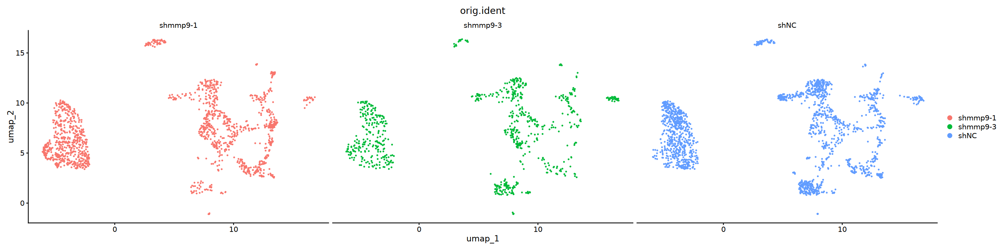

In [12]:
options(repr.plot.width = 24, repr.plot.height = 6)
DimPlot(seu, reduction = "umap", group.by = "orig.ident", split.by = "orig.ident")

In [3]:
# C7-T  C12-B
seu<- subset(seu, subset=RNA_snn_res.0.5!=7 &RNA_snn_res.0.5!=12)
tic()
# 标准化
seu <- NormalizeData(seu,
                    normalization.method = "LogNormalize",
                    scale.factor = 10000,
                    block.size = 800)

# 寻找高变基因
seu <- FindVariableFeatures(seu,
                          selection.method = "vst",
                          nfeatures = 2000)

# 数据标准化
plan("sequential")  # 临时切换到串行模式
seu <- ScaleData(seu,
                features = rownames(seu),
                block.size = 1000,
                min.cells.to.block = 1000)
plan("multicore", workers = 54)  # 恢复并行模式
toc()

tic()
# 运行PCA
seu <- RunPCA(seu, npcs = 30, verbose = FALSE)

# 运行Harmony
seu <- RunHarmony(seu,
                 group.by.vars = "orig.ident",
                 seed.use = 1234)

# 运行UMAP
seu <- RunUMAP(seu,
              reduction = "harmony",
              dims = 1:30,
              umap.method = "umap-learn",
              metric = "correlation",
              verbose = FALSE)
toc()

seu <- FindNeighbors(object = seu,
                    dims = 1:30,
                    verbose = FALSE, 
                    reduction = "harmony")

# 不同分辨率的聚类和可视化
resolution.range <- seq(0.1, 1.2, by = 0.1)
plot_list <- list()

for (res in resolution.range) {
    # 进行聚类
    seu <- FindClusters(seu,
        resolution = res,
        verbose = FALSE,
        random.seed = 1234)
    
    cluster_column <- paste0("RNA_snn_res.", res)
    
    p <- DimPlot(seu,
        reduction = "umap",
        group.by = cluster_column,
        label = TRUE,
        label.size = 4) +
        ggtitle(paste("Resolution:", res))
    
    plot_list[[length(plot_list) + 1]] <- p
}

Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix



11.085 sec elapsed


Transposing data matrix

Initializing state using k-means centroids initialization

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony converged after 4 iterations



77.993 sec elapsed


Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "igno

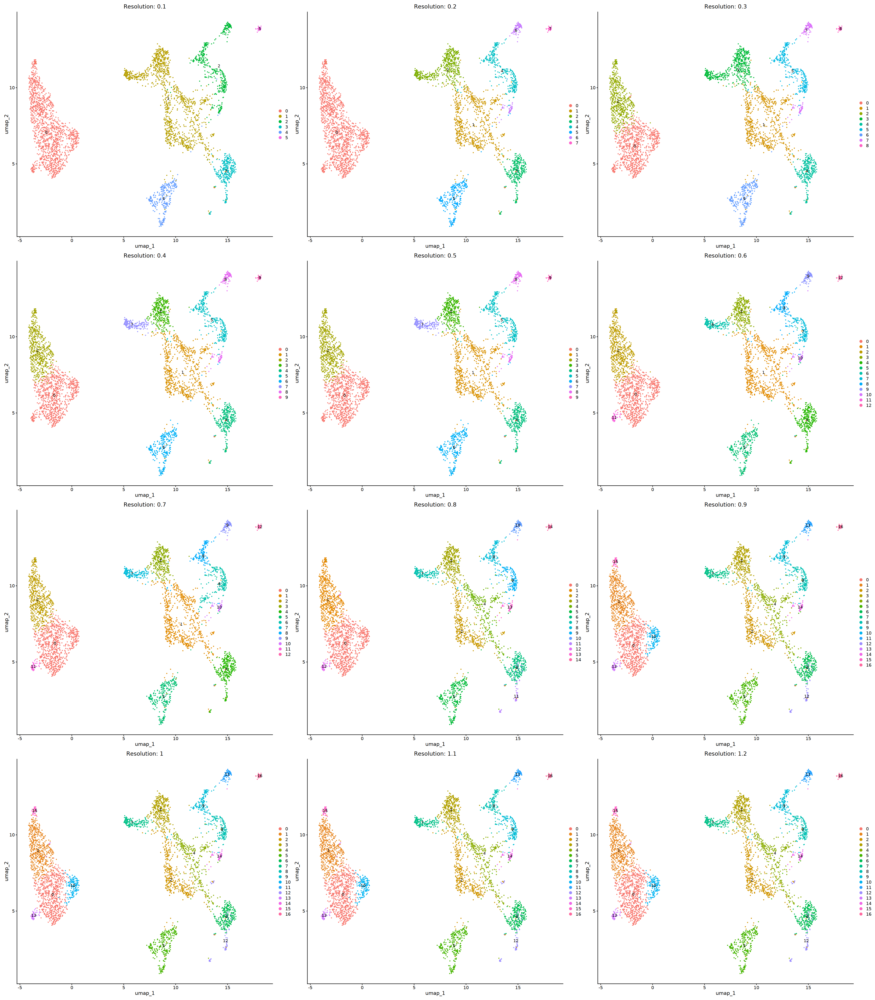

In [14]:
options(repr.plot.width = 35, repr.plot.height = 40)
wrap_plots(plot_list, ncol = 3)

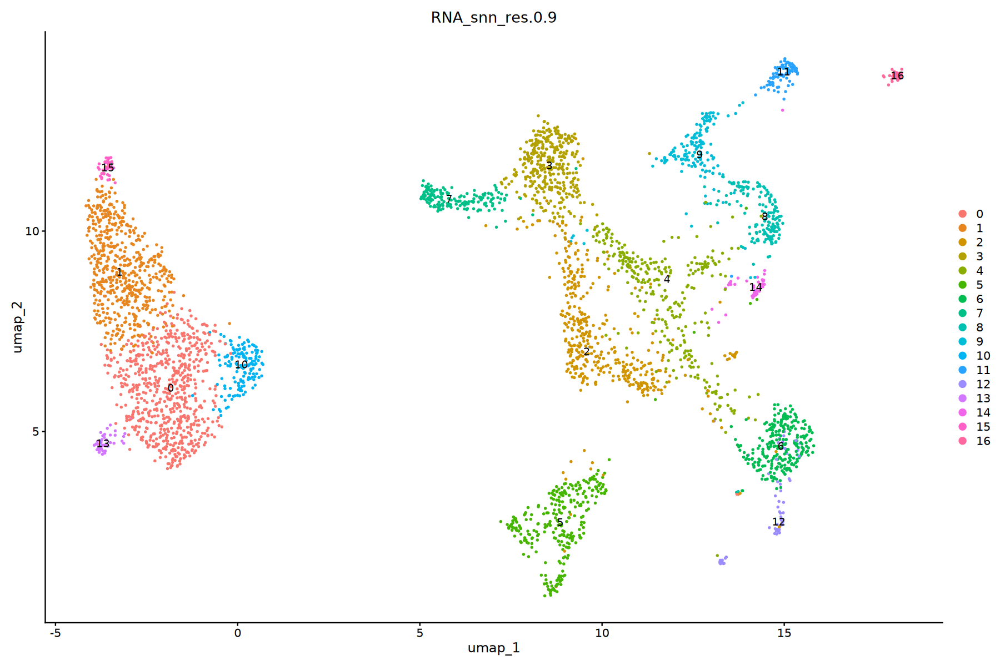

In [16]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(seu,
        reduction = "umap",
        group.by = "RNA_snn_res.0.9",
        label = TRUE,
        label.size = 4,
        pt.size = 0.5)

In [15]:
cluster_col <- "RNA_snn_res.0.9"
seu <- JoinLayers(seu)
Idents(seu) <- cluster_col

cosg_markers <- cosg(
   seu,
   groups = 'all',
   mu = 1
)

avg_expr <- AggregateExpression(
   seu,
   group.by = cluster_col,
   assays = "RNA"
)$RNA

cluster_vec <- rep(names(cosg_markers$names), sapply(cosg_markers$names, length))
genes_vec <- unlist(cosg_markers$names)
scores_vec <- unlist(cosg_markers$scores)

cosg_results_df <- data.frame(
   cluster = cluster_vec,
   Gene = genes_vec,
   Score = scores_vec,
   stringsAsFactors = FALSE
)

cluster_names <- paste0("g", cosg_results_df$cluster)
cosg_results_df$Avg_Expression <- NA

genes_match <- match(cosg_results_df$Gene, rownames(avg_expr))
clusters_match <- match(cluster_names, colnames(avg_expr))
valid_indices <- !is.na(genes_match) & !is.na(clusters_match)
cosg_results_df$Avg_Expression[valid_indices] <- round(
   avg_expr[cbind(
       genes_match[valid_indices], 
       clusters_match[valid_indices]
   )],
   3
)

cosg_results_df$cluster <- as.numeric(cosg_results_df$cluster)
cosg_results_df <- cosg_results_df[order(cosg_results_df$cluster, -cosg_results_df$Score),]

excel_data <- split(cosg_results_df, cosg_results_df$cluster)
excel_data <- lapply(excel_data, function(x) {
   x <- x[order(-x$Score),]
   x$cluster <- NULL
   return(x)
})
names(excel_data) <- paste0("Cluster", names(excel_data))

resolution <- sub(".*res\\.", "", cluster_col)

excel_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".xlsx")
csv_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".csv")

write_xlsx(excel_data, path = file.path(output_path, excel_filename))
data.table::fwrite(cosg_results_df, file = file.path(output_path, csv_filename))

Warning message:
“x or y has vectors with all zero; consider setting use_nan = TRUE to set these values to NaN or use_nan = FALSE to suppress this warning”


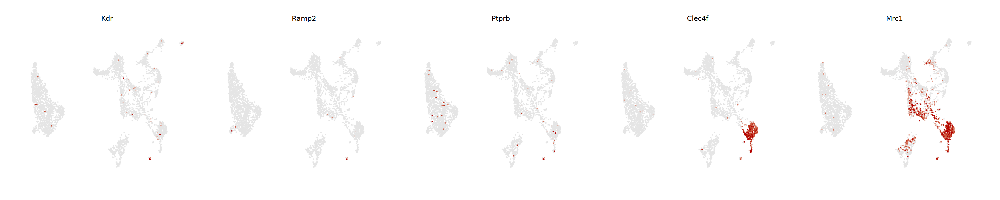

In [19]:
options(repr.plot.width = 25, repr.plot.height = 5)

# 创建FeaturePlot
FeaturePlot(seu,
    features = c( "Kdr", "Ramp2", "Ptprb", "Clec4f", "Mrc1"),
    ncol = 5,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

In [5]:
# C12 内皮+KC
seu<- subset(seu, subset=RNA_snn_res.0.9!=12)
tic()
# 标准化
seu <- NormalizeData(seu,
                    normalization.method = "LogNormalize",
                    scale.factor = 10000,
                    block.size = 800)

# 寻找高变基因
seu <- FindVariableFeatures(seu,
                          selection.method = "vst",
                          nfeatures = 2000)

# 数据标准化
plan("sequential")  # 临时切换到串行模式
seu <- ScaleData(seu,
                features = rownames(seu),
                block.size = 1000,
                min.cells.to.block = 1000)
plan("multicore", workers = 54)  # 恢复并行模式
toc()

tic()
# 运行PCA
seu <- RunPCA(seu, npcs = 30, verbose = FALSE)

# 运行Harmony
seu <- RunHarmony(seu,
                 group.by.vars = "orig.ident",
                 seed.use = 1234)

# 运行UMAP
seu <- RunUMAP(seu,
              reduction = "harmony",
              dims = 1:30,
              umap.method = "umap-learn",
              metric = "correlation",
              verbose = FALSE)
toc()

seu <- FindNeighbors(object = seu,
                    dims = 1:30,
                    verbose = FALSE, 
                    reduction = "harmony")

# 不同分辨率的聚类和可视化
resolution.range <- seq(0.1, 1.2, by = 0.1)
plot_list <- list()

for (res in resolution.range) {
    # 进行聚类
    seu <- FindClusters(seu,
        resolution = res,
        verbose = FALSE,
        random.seed = 1234)
    
    cluster_column <- paste0("RNA_snn_res.", res)
    
    p <- DimPlot(seu,
        reduction = "umap",
        group.by = cluster_column,
        label = TRUE,
        label.size = 4) +
        ggtitle(paste("Resolution:", res))
    
    plot_list[[length(plot_list) + 1]] <- p
}

Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix



13.181 sec elapsed


Transposing data matrix

Initializing state using k-means centroids initialization

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony converged after 4 iterations



48.321 sec elapsed


Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "igno

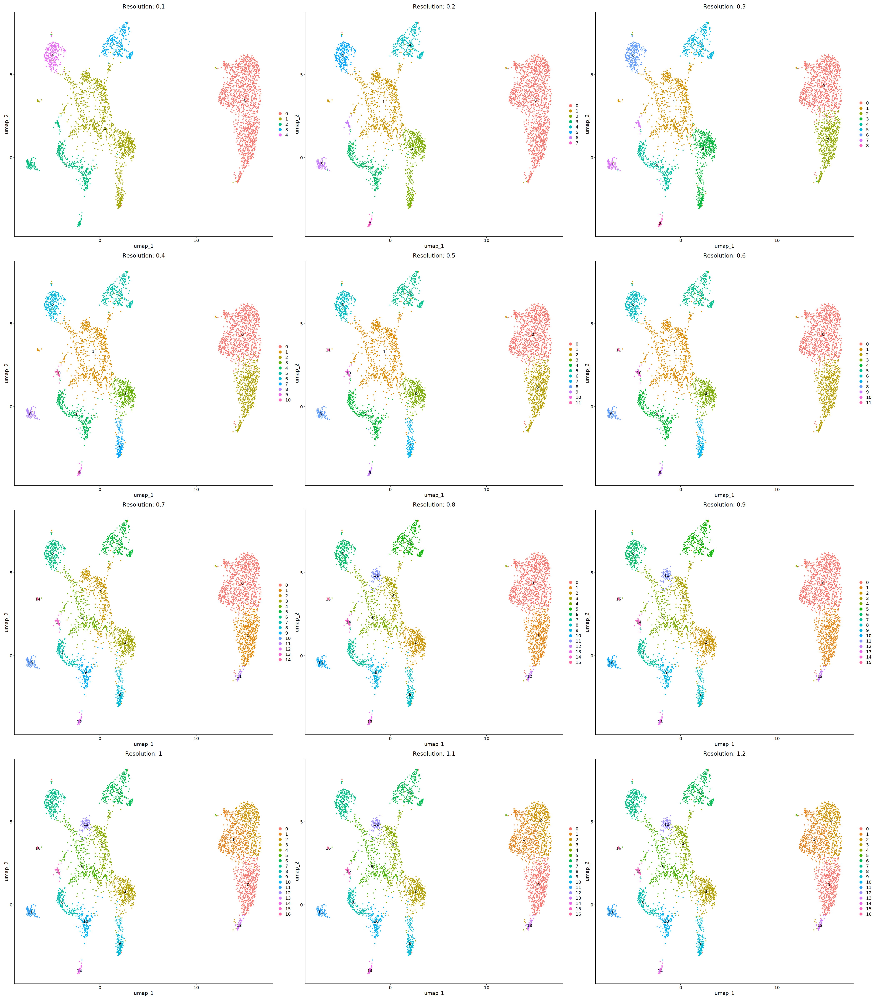

In [21]:
options(repr.plot.width = 35, repr.plot.height = 40)
wrap_plots(plot_list, ncol = 3)

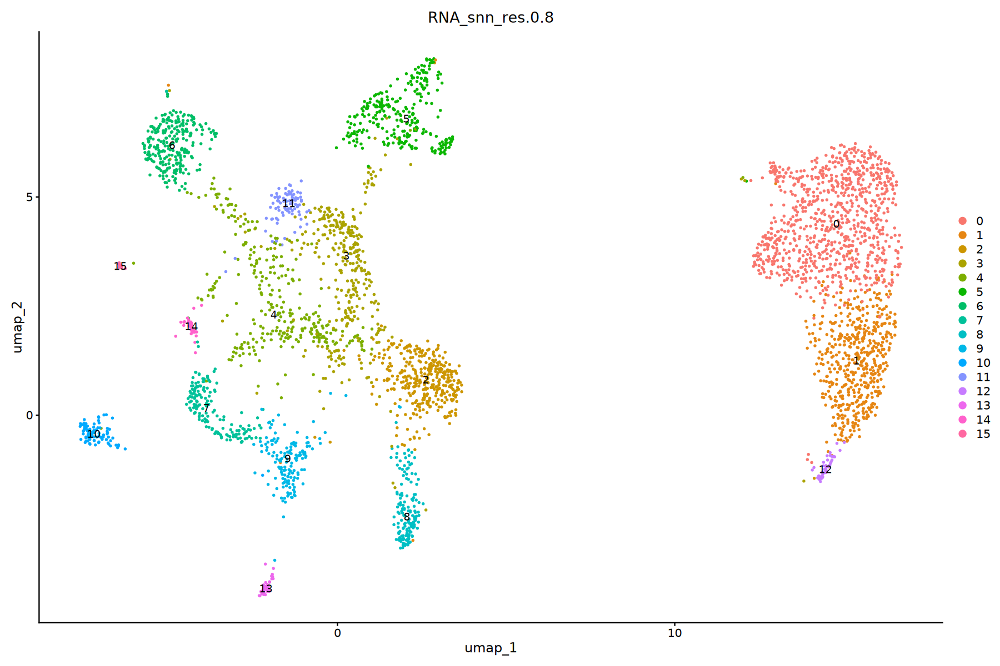

In [23]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(seu,
        reduction = "umap",
        group.by = "RNA_snn_res.0.8",
        label = TRUE,
        label.size = 4,
        pt.size = 0.5)

In [22]:
cluster_col <- "RNA_snn_res.0.8"
seu <- JoinLayers(seu)
Idents(seu) <- cluster_col

cosg_markers <- cosg(
   seu,
   groups = 'all',
   mu = 1
)

avg_expr <- AggregateExpression(
   seu,
   group.by = cluster_col,
   assays = "RNA"
)$RNA

cluster_vec <- rep(names(cosg_markers$names), sapply(cosg_markers$names, length))
genes_vec <- unlist(cosg_markers$names)
scores_vec <- unlist(cosg_markers$scores)

cosg_results_df <- data.frame(
   cluster = cluster_vec,
   Gene = genes_vec,
   Score = scores_vec,
   stringsAsFactors = FALSE
)

cluster_names <- paste0("g", cosg_results_df$cluster)
cosg_results_df$Avg_Expression <- NA

genes_match <- match(cosg_results_df$Gene, rownames(avg_expr))
clusters_match <- match(cluster_names, colnames(avg_expr))
valid_indices <- !is.na(genes_match) & !is.na(clusters_match)
cosg_results_df$Avg_Expression[valid_indices] <- round(
   avg_expr[cbind(
       genes_match[valid_indices], 
       clusters_match[valid_indices]
   )],
   3
)

cosg_results_df$cluster <- as.numeric(cosg_results_df$cluster)
cosg_results_df <- cosg_results_df[order(cosg_results_df$cluster, -cosg_results_df$Score),]

excel_data <- split(cosg_results_df, cosg_results_df$cluster)
excel_data <- lapply(excel_data, function(x) {
   x <- x[order(-x$Score),]
   x$cluster <- NULL
   return(x)
})
names(excel_data) <- paste0("Cluster", names(excel_data))

resolution <- sub(".*res\\.", "", cluster_col)

excel_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".xlsx")
csv_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-", resolution, ".csv")

write_xlsx(excel_data, path = file.path(output_path, excel_filename))
data.table::fwrite(cosg_results_df, file = file.path(output_path, csv_filename))

Warning message:
“x or y has vectors with all zero; consider setting use_nan = TRUE to set these values to NaN or use_nan = FALSE to suppress this warning”


In [7]:
# C12 中性粒  C15 低质量细胞
seu<- subset(seu, subset=RNA_snn_res.0.8!=12&RNA_snn_res.0.8!=15)
tic()
# 标准化
seu <- NormalizeData(seu,
                    normalization.method = "LogNormalize",
                    scale.factor = 10000,
                    block.size = 800)

# 寻找高变基因
seu <- FindVariableFeatures(seu,
                          selection.method = "vst",
                          nfeatures = 2000)

# 数据标准化
plan("sequential")  # 临时切换到串行模式
seu <- ScaleData(seu,
                features = rownames(seu),
                block.size = 1000,
                min.cells.to.block = 1000)
plan("multicore", workers = 54)  # 恢复并行模式
toc()

tic()
# 运行PCA
seu <- RunPCA(seu, npcs = 30, verbose = FALSE)

# 运行Harmony
seu <- RunHarmony(seu,
                 group.by.vars = "orig.ident",
                 seed.use = 1234)

# 运行UMAP
seu <- RunUMAP(seu,
              reduction = "harmony",
              dims = 1:30,
              umap.method = "umap-learn",
              metric = "correlation",
              verbose = FALSE)
toc()

seu <- FindNeighbors(object = seu,
                    dims = 1:30,
                    verbose = FALSE, 
                    reduction = "harmony")

# 不同分辨率的聚类和可视化
resolution.range <- seq(0.1, 1.2, by = 0.1)
plot_list <- list()

for (res in resolution.range) {
    # 进行聚类
    seu <- FindClusters(seu,
        resolution = res,
        verbose = FALSE,
        random.seed = 1234)
    
    cluster_column <- paste0("RNA_snn_res.", res)
    
    p <- DimPlot(seu,
        reduction = "umap",
        group.by = cluster_column,
        label = TRUE,
        label.size = 4) +
        ggtitle(paste("Resolution:", res))
    
    plot_list[[length(plot_list) + 1]] <- p
}

Normalizing layer: counts

Finding variable features for layer counts

Centering and scaling data matrix



12.792 sec elapsed


Transposing data matrix

Initializing state using k-means centroids initialization

Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony converged after 4 iterations



50.972 sec elapsed


Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "ignore".”
Warning message:
“UNRELIABLE VALUE: One of the ‘future.apply’ iterations (‘future_lapply-1’) unexpectedly generated random numbers without declaring so. There is a risk that those random numbers are not statistically sound and the overall results might be invalid. To fix this, specify 'future.seed=TRUE'. This ensures that proper, parallel-safe random numbers are produced via the L'Ecuyer-CMRG method. To disable this check, use 'future.seed = NULL', or set option 'future.rng.onMisuse' to "igno

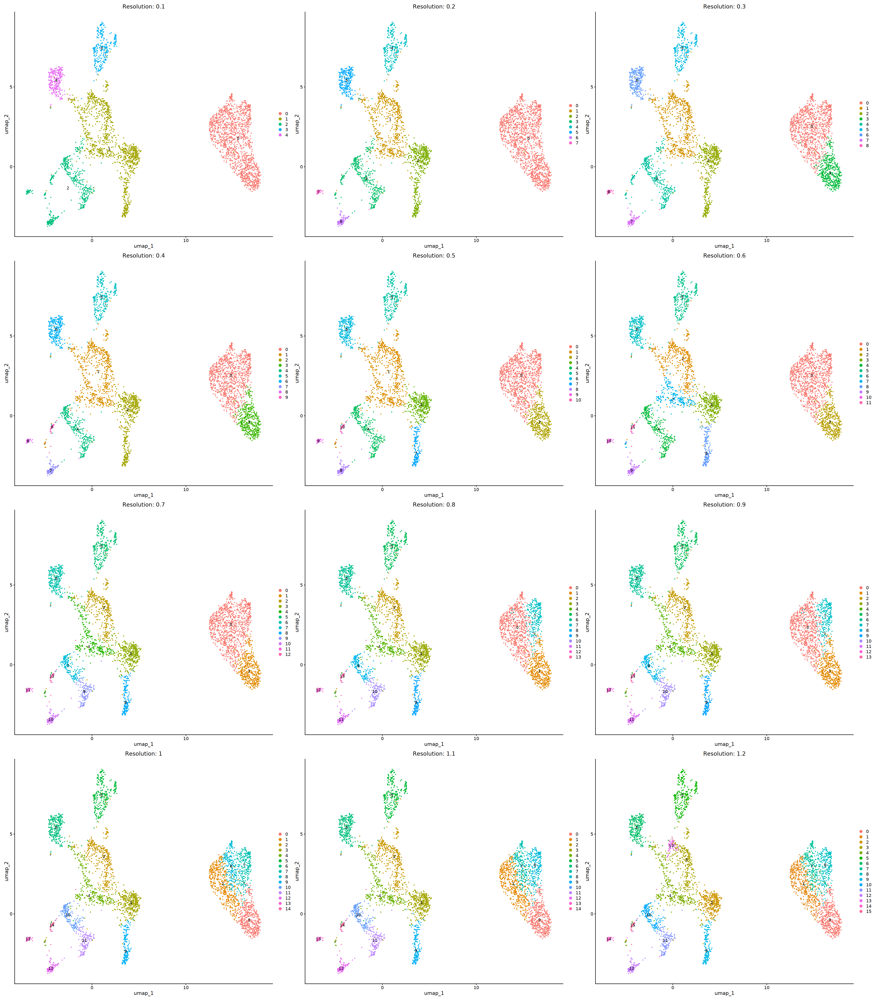

In [25]:
options(repr.plot.width = 35, repr.plot.height = 40)
wrap_plots(plot_list, ncol = 3)

In [27]:
cluster_col <- "RNA_snn_res.0.8"
seu <- JoinLayers(seu)
Idents(seu) <- cluster_col

cosg_markers <- cosg(
   seu,
   groups = 'all',
   mu = 1
)

avg_expr <- AggregateExpression(
   seu,
   group.by = cluster_col,
   assays = "RNA"
)$RNA

cluster_vec <- rep(names(cosg_markers$names), sapply(cosg_markers$names, length))
genes_vec <- unlist(cosg_markers$names)
scores_vec <- unlist(cosg_markers$scores)

cosg_results_df <- data.frame(
   cluster = cluster_vec,
   Gene = genes_vec,
   Score = scores_vec,
   stringsAsFactors = FALSE
)

cluster_names <- paste0("g", cosg_results_df$cluster)
cosg_results_df$Avg_Expression <- NA

genes_match <- match(cosg_results_df$Gene, rownames(avg_expr))
clusters_match <- match(cluster_names, colnames(avg_expr))
valid_indices <- !is.na(genes_match) & !is.na(clusters_match)
cosg_results_df$Avg_Expression[valid_indices] <- round(
   avg_expr[cbind(
       genes_match[valid_indices], 
       clusters_match[valid_indices]
   )],
   3
)

cosg_results_df$cluster <- as.numeric(cosg_results_df$cluster)
cosg_results_df <- cosg_results_df[order(cosg_results_df$cluster, -cosg_results_df$Score),]

excel_data <- split(cosg_results_df, cosg_results_df$cluster)
excel_data <- lapply(excel_data, function(x) {
   x <- x[order(-x$Score),]
   x$cluster <- NULL
   return(x)
})
names(excel_data) <- paste0("Cluster", names(excel_data))

resolution <- sub(".*res\\.", "", cluster_col)

excel_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-8", resolution, ".xlsx")
csv_filename <- paste0("Mono-Mac+Mac+DC-cosg_markers-8", resolution, ".csv")

write_xlsx(excel_data, path = file.path(output_path, excel_filename))
data.table::fwrite(cosg_results_df, file = file.path(output_path, csv_filename))

Warning message:
“x or y has vectors with all zero; consider setting use_nan = TRUE to set these values to NaN or use_nan = FALSE to suppress this warning”


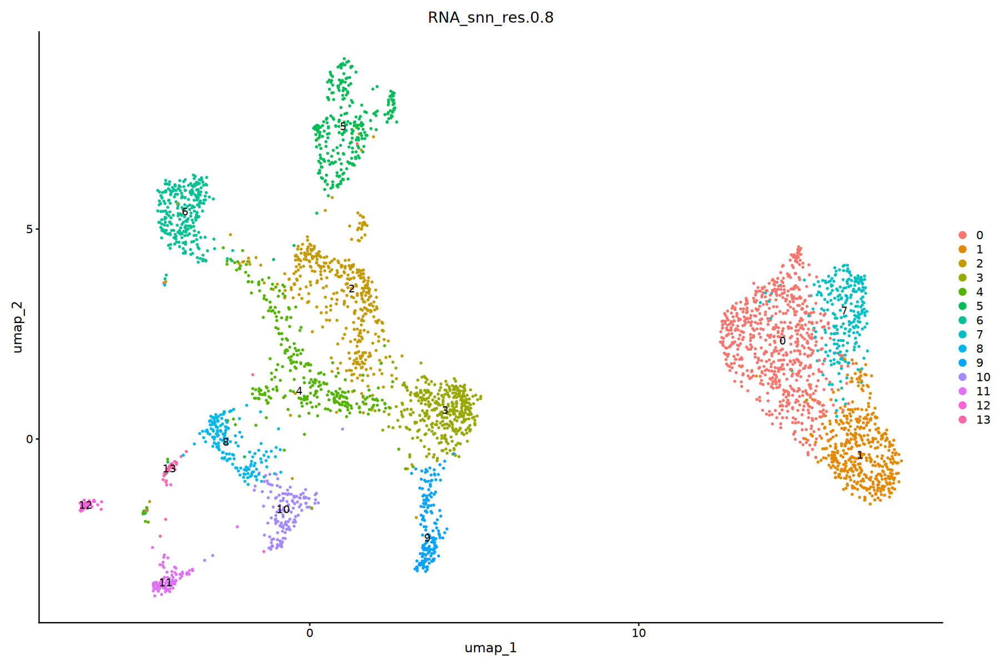

In [28]:
options(repr.plot.width = 15, repr.plot.height = 10)
DimPlot(seu,
        reduction = "umap",
        group.by = "RNA_snn_res.0.8",
        label = TRUE,
        label.size = 4,
        pt.size = 0.5)

1 2 7 cxcl12 Mac
2 Transitioning monocyte
3Ly6c hi mono
9 Patrolling monocyte
10 cDC2
11 cDC1
12 pDC

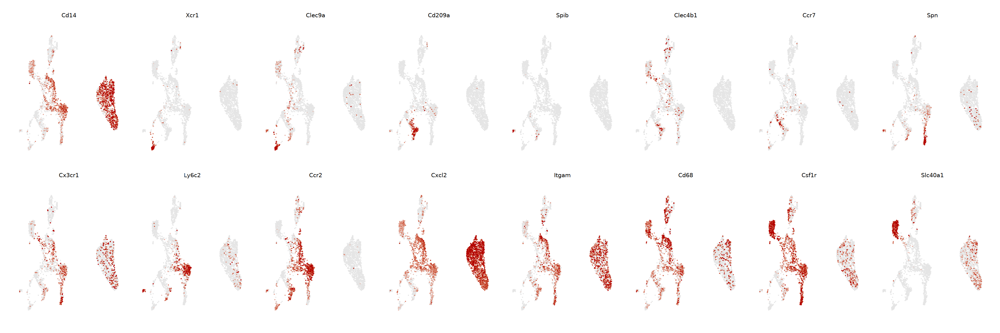

In [38]:
# 设置图形大小
options(repr.plot.width = 30, repr.plot.height = 10)

# 创建FeaturePlot
FeaturePlot(seu,
    features = c( "Cd14", "Xcr1", "Clec9a", "Cd209a", "Spib", "Clec4b1", "Ccr7","Spn", "Cx3cr1", "Ly6c2", "Ccr2", "Cxcl2", "Itgam", "Cd68","Csf1r", "Slc40a1"),
    ncol = 8,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

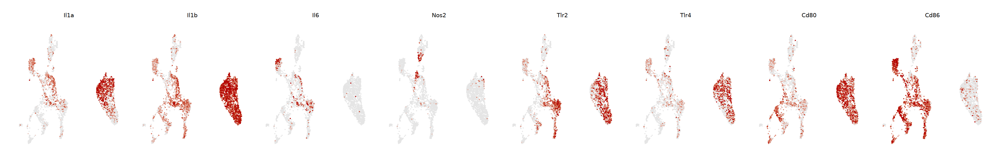

In [35]:
# 设置图形大小
options(repr.plot.width = 30, repr.plot.height = 5)
# M1
FeaturePlot(seu,
    features = c("Il1a", "Il1b", "Il6", "Nos2", "Tlr2", "Tlr4", "Cd80", "Cd86"),
    ncol = 8,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

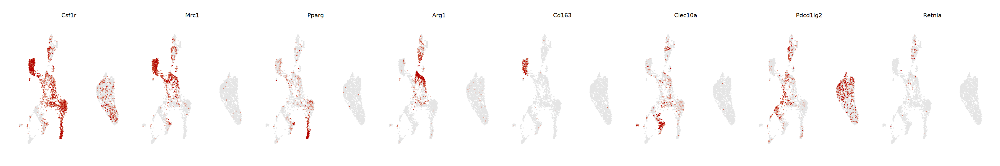

In [37]:
# 设置图形大小
options(repr.plot.width = 30, repr.plot.height = 5)
# M2
FeaturePlot(seu,
    features = c("Csf1r", "Mrc1", "Pparg", "Arg1", "Cd163", "Clec10a","Pdcd1lg2", "Retnla"),
    ncol = 8,
    pt.size = 0.1,
    order = TRUE,
    reduction = "umap",
    cols = c("grey90", "#B30000"),
    min.cutoff = "q10",
    max.cutoff = "q90"
) &
theme_minimal() &
theme(
    plot.title = element_text(size = 12, face = "bold", hjust = 0.5),  # 标题居中
    strip.text = element_text(size = 12, face = "bold", hjust = 0.5),  # 分面标题居中
    axis.title = element_blank(),    # 移除轴标题
    axis.text = element_blank(),     # 移除轴文本
    axis.ticks = element_blank(),    # 移除轴刻度线
    legend.position = "none",        # 移除图例
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    plot.margin = margin(0.5, 0.5, 0.5, 0.5, "cm")
)

cluster_mapping <- c(
    "0" = "Inflammatory macrophages",
    "1" = "Emergency macrophages",
    "2" = "Resolution macrophages", 
    "3" = "Classical monocytes",
    "4" = "Resident macrophages",
    "5" = "Activated macrophages",
    "6" = "Kupffer cells",
    "7" = "Inflammatory monocyte-derived cells",
    "8" = "Antigen-presenting macrophages",
    "9" = "Non-classical monocytes",
    "10" = "cDC2",
    "11" = "cDC1",
    "12" = "pDC",
    "13" = "Proliferating myeloid cells"
)

cluster_mapping <- c(
    "0" = "Recruiting M1",      # Recruited → Recruiting
    "1" = "Emerging M1",        # Acute → Emerging
    "2" = "Resolving M2",       # 已经是-ing形式
    "3" = "Ly6Chi Monocytes",   # 专有名词保持
    "4" = "Homeostatic Mac",    # 形容词保持
    "5" = "Signaling M1",       # Chemokine → Signaling
    "6" = "Kupffer Cells",      # 专有名词保持
    "7" = "Responding M1",      # Early Response → Responding
    "8" = "MHCII+ Mac",         # 标记型名词保持
    "9" = "Patrolling M2",      # 已经是-ing形式
    "10" = "cDC2",             # 专有名词保持
    "11" = "cDC1",             # 专有名词保持
    "12" = "pDC",              # 专有名词保持
    "13" = "Proliferating Myeloid"  # 已经是-ing形式
)

In [21]:
cluster_mapping <- c(
  "0" = "Pro-inflammatory recruited Mac",
  "1" = "Acute phase response Mac",
  "2" = "Transitioning inflammatory Mac",
  "3" = "Ly6Chi Classical monocytes",
  "4" = "Homeostatic tissue Mac",
  "5" = "Chemokine-secreting activated Mac",
  "6" = "Kupffer cells",
  "7" = "Early response Mac",
  "8" = "Antigen-presenting Mac",
  "9" = "Patrolling monocytes",
  "10" = "cDC2",
  "11" = "cDC1",
  "12" = "pDC",
  "13" = "Proliferating myeloid cells"
)


# 2. 设置聚类顺序和celltype
Idents(seu) <- seu$RNA_snn_res.0.8
cluster_order <- names(cluster_mapping)
seu$celltype <- plyr::mapvalues(
 Idents(seu),
 from = names(cluster_mapping),
 to = unname(cluster_mapping)
)

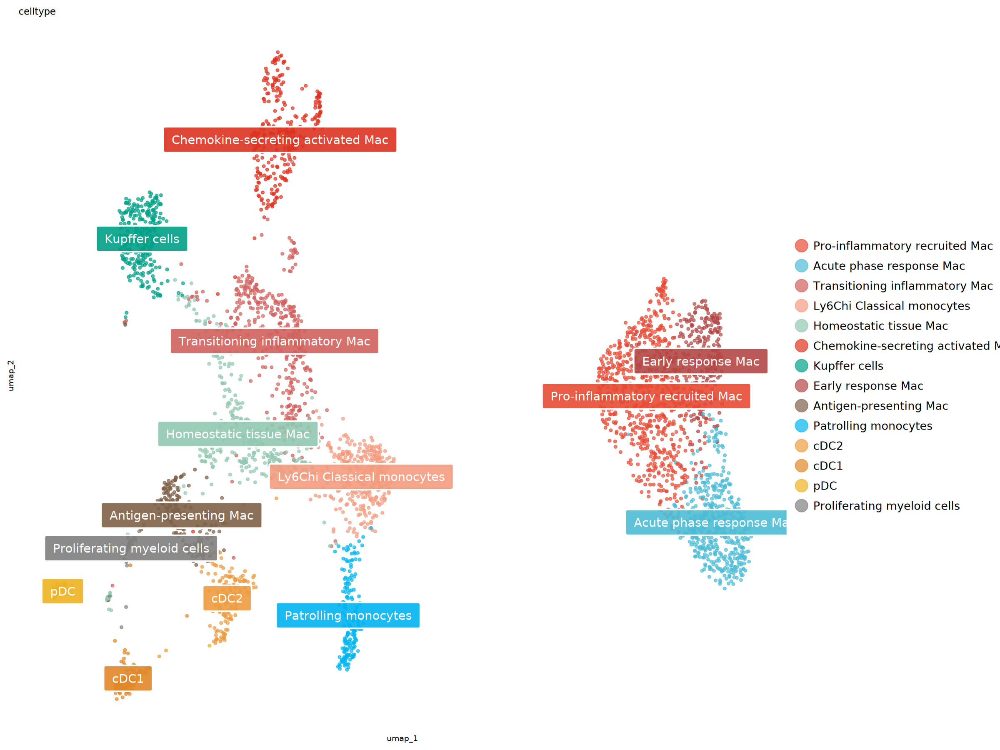

In [16]:
custom_colors <- c(
    "Pro-inflammatory recruited Mac" = "#E64B35",    # 0 
    "Acute phase response Mac" = "#4DBBD5",         # 1
    "Transitioning inflammatory Mac" = "#D1615D",    # 2
    "Ly6Chi Classical monocytes" = "#F39B7F",       # 3
    "Homeostatic tissue Mac" = "#91C7B1",           # 4
    "Chemokine-secreting activated Mac" = "#DC3220", # 5
    "Kupffer cells" = "#00A087",                    # 6
    "Early response Mac" = "#B24745",               # 7
    "Antigen-presenting Mac" = "#7E6148",           # 8
    "Patrolling monocytes" = "#00B4F0",             # 9
    "cDC2" = "#ED9B40",                            # 10
    "cDC1" = "#E18727",                            # 11
    "pDC" = "#EDB120",                             # 12
    "Proliferating myeloid cells" = "#7E7E7E"       # 13
)

# 创建UMAP图
p1 <- DimPlot(seu,
              reduction = "umap",
              group.by = "celltype",
              label = FALSE,
              cols = custom_colors,
              pt.size = 1.5,
              repel = TRUE,
              alpha = 0.7) +
    theme_minimal() +
    theme(
      legend.position = "right",
      legend.text = element_text(size = 16),
      legend.title = element_blank(),
      legend.box = "vertical",
      legend.margin = margin(t = 0, r = 0, b = 0, l = 0),
      panel.grid = element_blank(),
      axis.text = element_blank()
    ) +
    guides(color = guide_legend(ncol = 1, override.aes = list(size = 8), keyheight = 2)) +
    geom_label(data = cell_centers,
               aes(x = umap_1,
                   y = umap_2,
                   label = celltype,
                   fill = celltype),
               color = "white",
               fontface = "bold",
               alpha = 0.9,
               size = 6,
               label.size = 0.8,
               label.padding = unit(0.6, "lines")) +
    scale_fill_manual(values = custom_colors, guide = "none")

# 显示图形
options(repr.plot.width = 20, repr.plot.height = 15)
print(p1)

In [22]:
head(seu@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,RNA_snn_res.0.8,celltype
,<chr>,<dbl>,<int>,<fct>,<fct>
NC_AAACCCACAAAGTATG-1,shNC,7575,2469,4,Homeostatic tissue Mac
NC_AAACCCACATTGACAC-1,shNC,3101,1292,1,Acute phase response Mac
NC_AAACCCAGTAGGCTCC-1,shNC,3216,1252,0,Pro-inflammatory recruited Mac
NC_AAACCCATCACCTCTG-1,shNC,1780,910,1,Acute phase response Mac
NC_AAACGAACATATGCGT-1,shNC,9506,3165,2,Transitioning inflammatory Mac
NC_AAACGAAGTGAGACCA-1,shNC,4426,2005,3,Ly6Chi Classical monocytes


In [20]:
required_columns <- c(
    "orig.ident",
    "nCount_RNA",      # RNA计数
    "nFeature_RNA",    # 基因数
    "RNA_snn_res.0.8"    # 聚类信息
)

# 只保留需要的列
seu@meta.data <- seu@meta.data[, required_columns]
head(seu@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,RNA_snn_res.0.8
,<chr>,<dbl>,<int>,<fct>
NC_AAACCCACAAAGTATG-1,shNC,7575,2469,4
NC_AAACCCACATTGACAC-1,shNC,3101,1292,1
NC_AAACCCAGTAGGCTCC-1,shNC,3216,1252,0
NC_AAACCCATCACCTCTG-1,shNC,1780,910,1
NC_AAACGAACATATGCGT-1,shNC,9506,3165,2
NC_AAACGAAGTGAGACCA-1,shNC,4426,2005,3


In [23]:
output_path <- "/data3/Group8/gonglihao/1-MMP9/5-sub"
saveRDS(seu, file = file.path(output_path, "Mono-Mac+Mac+DC-Annotation.rds"))